In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import lightkurve as lk
import matplotlib.animation as animation
import matplotlib.colors as colors
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

from IPython.display import HTML
from astropy.stats import sigma_clip
from tessrip import Rip
from astropy.time import Time
from tqdm import tqdm

DARADIR = "/Users/jorgemarpa/Work/BAERI/ADAP/tess-asteroid-ml/data"

In [2]:
sector = 7
camera = 3
ccd = 4

In [3]:
track = pd.read_csv(f"{DARADIR}/pred_asteroid_tracks/sector{sector:04}/{camera}-{ccd}/asteroid_positions_s{sector:04}-{camera}-{ccd}_001.csv")
track

,mjd,row,column
0,2.458494e+06,1889.200000,109.500000
1,2.458494e+06,1883.000000,118.642857
2,2.458494e+06,1875.904762,127.952381
3,2.458495e+06,1870.117647,136.000000
4,2.458495e+06,1864.000000,144.705882
...,...,...,...
88,2.458496e+06,1979.357143,359.714286
89,2.458496e+06,1988.000000,356.625000
90,2.458496e+06,1996.533333,354.333333
91,2.458496e+06,2006.133333,351.400000


In [4]:
track.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93 entries, 0 to 92
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   mjd     93 non-null     float64
 1   row     93 non-null     float64
 2   column  93 non-null     float64
dtypes: float64(3)
memory usage: 2.3 KB


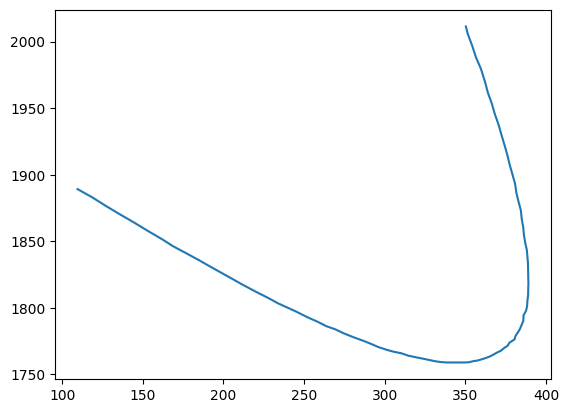

In [5]:
plt.plot(track.column, track.row)
plt.show()

In [6]:
corner = np.floor((np.maximum(0, track.row.min() - 20), np.maximum(44, track.column.min() - 20))).astype(int)
size = np.ceil((np.minimum(2048, track.row.max() + 20), np.minimum(2096, track.column.max() + 20))).astype(int)
size -= corner
print(corner)
print(size)

[1739   89]
[293 321]


In [7]:
rips = Rip(sector=sector, camera=camera, ccd=ccd)

In [8]:
flx, flx_e = rips.get_flux(shape=tuple(size), corner=tuple(corner))
flx.array.shape, flx_e.array.shape

((1093, 293, 321), (1093, 293, 321))

In [9]:
row, col = np.mgrid[corner[0] : corner[0] + size[0], corner[1] : corner[1] + size[1]]
row.shape, col.shape

((293, 321), (293, 321))

In [10]:
rips.cadence_number.array.shape, rips.quality.array.shape, rips.time.array.shape

((1093,), (1093,), (1093,))

In [11]:
ffi_time = Time(rips.time.array + 2457000, format="mjd", scale="tdb").mjd

In [12]:
np.median(rips.last_hdulist[0].data["TELAPSE"])

0.020833324652

In [13]:
# find track cadence number
track_time = np.concatenate([[ffi_time[0]], track.mjd])
track_cad = np.cumsum(
            np.round(np.diff(track_time) / np.median(rips.last_hdulist[0].data["TELAPSE"]))
            ).astype(int)
track["cadenceno"] = track_cad

# correct track mjd
# track["mjd"] -= track.mjd.diff().median() #* np.diff(track.cadenceno)

track["ffi_index"] = np.array([np.where(np.isclose(d, ffi_time, atol=0.01, rtol=0))[0] for d in track.mjd]).ravel() - 1
track["quality"] = rips.quality.array[track.ffi_index.values].astype(int)
track

,mjd,row,column,cadenceno,ffi_index,quality
0,2.458494e+06,1889.200000,109.500000,135,134,0
1,2.458494e+06,1883.000000,118.642857,136,135,0
2,2.458494e+06,1875.904762,127.952381,137,136,0
3,2.458495e+06,1870.117647,136.000000,138,137,0
4,2.458495e+06,1864.000000,144.705882,139,138,0
...,...,...,...,...,...,...
88,2.458496e+06,1979.357143,359.714286,224,223,0
89,2.458496e+06,1988.000000,356.625000,225,224,0
90,2.458496e+06,1996.533333,354.333333,226,225,0
91,2.458496e+06,2006.133333,351.400000,227,226,0


In [14]:
track.quality.value_counts()

0      92
160     1
Name: quality, dtype: int64

In [15]:
to_stack = sigma_clip(flx.array[track.query("quality == 0")["ffi_index"].values], axis=0, sigma=3, cenfunc="median", masked=False)
statics = np.median(to_stack, axis=0)
statics = np.median(flx.array[track["ffi_index"].values], axis=0)
statics.shape

(293, 321)

In [16]:
def animate_2d_data(col, row, data, track,
                    x_axis_label="Column", 
                    y_axis_label="Row", interval=200, repeat_delay=1000):
    """
    Animates 2D input data as a function of track.mjd.values.

    Args:
        data (numpy.ndarray): The 2D input data.
        x_axis_label (str, optional): The label for the x-axis. Defaults to "X".
        y_axis_label (str, optional): The label for the y-axis. Defaults to "Y".
        interval (int, optional): Delay between frames in milliseconds. Defaults to 20.
        repeat_delay (int, optional): Delay before repeating the animation in milliseconds. Defaults to 1000.
    """

    vlo, lo, mid, hi, vhi = np.nanpercentile(data, [0.2, 1, 50, 95, 99.8])
    # print(vlo, lo, mid, hi, vhi)
    try:
        cnorm = colors.LogNorm(vmin=vlo, vmax=vhi)
    except ValueError:
        cnorm = colors.Normalize(vmin=vlo, vmax=vhi)

    fig, ax = plt.subplots()
    fig.suptitle(f"Asteroid Tracks in Sector {sector} Camera {camera} CCD {ccd}")
    im = ax.pcolormesh(
        col, row,
        data[0], 
        cmap="Greys_r",
        vmin=lo, 
        vmax=vhi,
        # norm=cnorm,
        rasterized=True
    )
    line = ax.plot(track.column.values[0], track.row.values[0], ".-", c="tab:red", alpha=.5, lw=1)[0]
    ax.axis('equal')
    ax.set_title(f"CAD {track.cadenceno.values[0]} | BTJD {track.mjd.values[0] - 2457000:.4f}")
    plt.colorbar(im, location="right", shrink=.8, label="Flux [-e/s]")

    def animate(i):
        im.set_array(data[i].ravel())
        line.set_xdata(track.column.values[:i])
        line.set_ydata(track.row.values[:i])
        ax.set_title(f"CAD {track.cadenceno.values[i]} | BTJD {track.mjd.values[i] - 2457000:.4f}")
        return (im, line, )

    plt.close(ax.figure)

    # Create the animation
    ani = animation.FuncAnimation(
        fig, animate, frames=len(data), interval=interval, blit=True, repeat_delay=repeat_delay, repeat=True,
    )

    ax.set_xlabel(x_axis_label)
    ax.set_ylabel(y_axis_label)

    # ax.plot(track.column, track.row, c="tab:red", alpha=.5, lw=1)

    return ani

In [164]:
track_ = track.query("quality == 0")
HTML(animate_2d_data(
    col, 
    row, 
    flx.array[track_.ffi_index.values] - statics, 
    track_
).to_jshtml())

In [221]:
# save animation to movie file
animate_2d_data(
    col, row, flx.array[cadence_track] - statics, ffi_time[cadence_track], cadence_track, track.iloc[2:]
).save("./data/asteroid_001_anim.mp4", writer="ffmpeg")

In [19]:
flx.array.shape

(1093, 293, 321)

In [32]:
cutout_size = 15
moving_flux, moving_flux_e = [], []

# we iter over track positions to get the moving tpf
for k, row in tqdm(track.iterrows(), total=len(track)):
    # print(k, row)
    corner = np.floor(row.row - cutout_size / 2), np.floor(row.column - cutout_size / 2)
    print(corner, (cutout_size, cutout_size), (int(row.ffi_index), int(row.ffi_index + 1)))
    
    frame, frame_e = rips.get_flux(shape=(cutout_size, cutout_size), 
                               corner=tuple(corner),
                               frame_range=(int(row.ffi_index), int(row.ffi_index + 1)),
                              )
    break

  0%|                                                                                                   | 0/93 [00:00<?, ?it/s]

(1881.0, 102.0) (15, 15) (134, 135)


  0%|                                                                                                   | 0/93 [00:24<?, ?it/s]


KeyboardInterrupt: 

In [33]:
frame, frame_e = rips.get_flux(shape=(cutout_size, cutout_size), 
                               corner=tuple(corner),
                               # frame_range=(int(row.ffi_index), int(row.ffi_index + 1)),
                              )

AioReadTimeoutError: Read timeout on endpoint URL: "https://stpubdata.s3.amazonaws.com/tess/public/mast/tess-s0007-3-4-cube.fits"

In [ ]:
frame